# Going Deeper(cv) 도로 영역을 찾자! - 세그멘테이션 모델 만들기 [프로젝트]

# 프로젝트 : 개선된 U-Net 모델 만들기

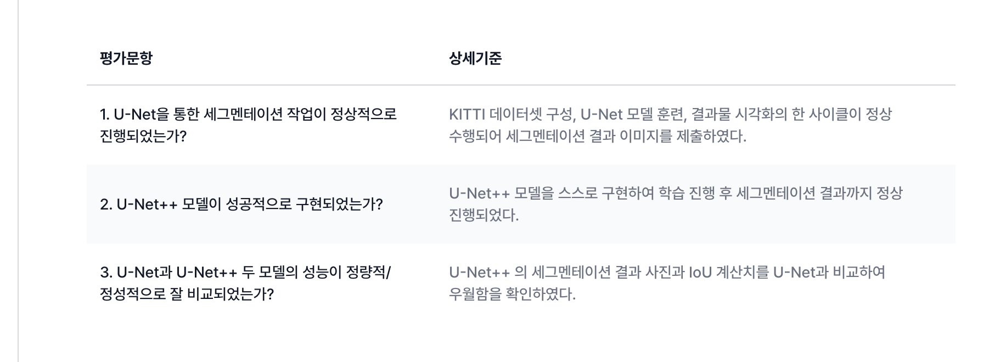

In [22]:
import os
import math
import numpy as np
import tensorflow as tf

from PIL import Image
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import resize
from glob import glob

from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *


## 1. KITTI 데이터셋 수집과 구축

## - dataloader

kitti dataset: http://www.cvlibs.net/datasets/kitti/eval_semantics.php


In [2]:
from albumentations import  HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

def build_augmentation(is_train=True):
    if is_train:
        # 훈련용 데이터일 경우
        return Compose([
                        HorizontalFlip(p=0.5),    # 50%의 확률로 좌우대칭
                        RandomSizedCrop(         # 50%의 확률로 RandomSizedCrop
                            min_max_height=(300, 370),
                            w2h_ratio=370/1242,
                            height=224,
                            width=224,
                            p=0.5
                            ),
                        Resize(              # 입력이미지를 224X224로 resize
                            width=224,
                            height=224
                            )
                        ])
    return Compose([      # 테스트용 데이터일 경우에는 224X224로 resize만 수행합니다. 
                Resize(
                    width=224,
                    height=224
                    )
                ])

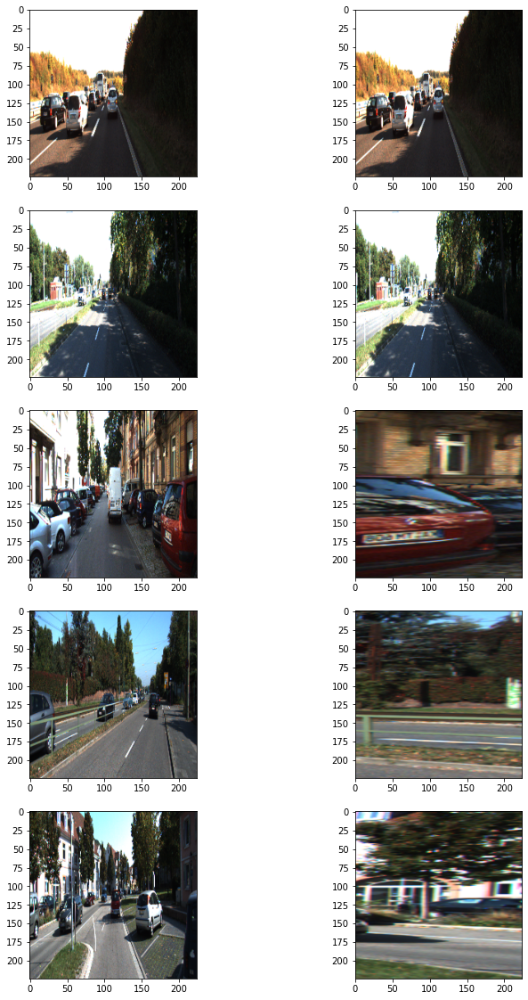

In [3]:
dir_path = os.getenv('HOME')+'/aiffel/workspace/semantic_segmentation/data/training'

augmentation_train = build_augmentation()
augmentation_test = build_augmentation(is_train=False)
input_images = glob(os.path.join(dir_path, "image_2", "*.png"))

# 훈련 데이터셋에서 5개만 가져와 augmentation을 적용해 봅시다.  
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i]) 
    image_data = {"image":image}
    resized = augmentation_test(**image_data)
    processed = augmentation_train(**image_data)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  # 왼쪽이 원본이미지
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"])  # 오른쪽이 augment된 이미지
    
plt.show()

In [4]:
# kitti dataset generator class

class KittiGenerator(tf.keras.utils.Sequence):
    '''
    KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
    우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
    '''
    def __init__(self, 
               dir_path,
               batch_size=16,
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               augmentation=None):
        
        self.dir_path = dir_path
        self.batch_size = batch_size
        self.is_train = is_train
        self.dir_path = dir_path
        self.augmentation = augmentation
        self.img_size = img_size
        self.output_size = output_size

        
        '''
        dir_path: dataset의 directory path입니다.
        batch_size: batch_size입니다.
        img_size: preprocess에 사용할 입력이미지의 크기입니다.
        output_size: ground_truth를 만들어주기 위한 크기입니다.
        is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
        augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
        '''

        # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
        self.data = self.load_dataset()
  
    def load_dataset(self):
        
        # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
        # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
        input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
        label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
        input_images.sort()
        label_images.sort()
        assert len(input_images) == len(label_images)
        data = [ _ for _ in zip(input_images, label_images)]

        if self.is_train:
            return data[:-30]
        return data[-30:]
    
    def __len__(self):
    
        # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
        return math.ceil(len(self.data) / self.batch_size)

    def __getitem__(self, index):
        # 입력과 출력을 만듭니다.
        # 입력은 resize및 augmentation이 적용된 input image이고 
        # 출력은 semantic label입니다.
        batch_data = self.data[
                               index*self.batch_size:
                               (index + 1)*self.batch_size
                               ]
        inputs = np.zeros([self.batch_size, *self.img_size])
        outputs = np.zeros([self.batch_size, *self.output_size])
        
        for i, data in enumerate(batch_data):
            input_img_path, output_path = data
            _input = imread(input_img_path)
            _output = imread(output_path)
            _output = (_output==7).astype(np.uint8)*1
            data = {
                "image": _input,
                "mask": _output,
                }
            augmented = self.augmentation(**data)
            inputs[i] = augmented["image"]/255
            outputs[i] = augmented["mask"]
            return inputs, outputs
        
    def on_epoch_end(self):
        
        # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
        self.indexes = np.arange(len(self.data))
        if self.is_train == True :
            np.random.shuffle(self.indexes)
            return self.indexes

In [5]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

## 2. U-Net++ 모델의 구현

In [6]:
# 비교를 위한 u-net model build

def build_model(input_shape=(224, 224, 3)):
    inputs = Input(input_shape)

    #Contracting Path
    conv1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool4)  
    conv5 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv5)

    #Expanding Path
    drop5 = Dropout(0.5)(conv5)
    up6 = Conv2D(512, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(drop5)) 
    merge6 = concatenate([drop4,up6], axis = 3)
    conv6 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv6)
    up7 = Conv2D(256, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv6))
    merge7 = concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv7)
    up8 = Conv2D(128, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv7))
    merge8 = concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv8)
    up9 = Conv2D(64, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv8))
    merge9 = concatenate([conv1,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)  
    conv9 = Conv2D(2, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)     
    conv10 = Conv2D(1, 1, activation='sigmoid')(conv9)

    model = Model(inputs = inputs, outputs = conv10)
    return model

In [8]:
import keras.callbacks

model_path = os.getenv('HOME')+'/aiffel/workspace/semantic_segmentation/models/unet.h5'

model = build_model()

checkpoint_cb = keras.callbacks.ModelCheckpoint(model_path)

model.compile(optimizer = Adam(learning_rate = 1e-4), loss = 'binary_crossentropy')
history_unet = model.fit(
     train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=100,
    callbacks=[checkpoint_cb]
 )

Epoch 1/100
11/11 [==============================] - 30s 856ms/step - loss: 0.6675 - val_loss: 0.5321
Epoch 2/100
11/11 [==============================] - 9s 823ms/step - loss: 0.1142 - val_loss: 0.0363
Epoch 3/100
11/11 [==============================] - 9s 794ms/step - loss: 0.0403 - val_loss: 0.0375
Epoch 4/100
11/11 [==============================] - 9s 784ms/step - loss: 0.0305 - val_loss: 0.0320
Epoch 5/100
11/11 [==============================] - 9s 780ms/step - loss: 0.0280 - val_loss: 0.0354
Epoch 6/100
11/11 [==============================] - 9s 783ms/step - loss: 0.0373 - val_loss: 0.0372
Epoch 7/100
11/11 [==============================] - 9s 787ms/step - loss: 0.0306 - val_loss: 0.0293
Epoch 8/100
11/11 [==============================] - 9s 792ms/step - loss: 0.0234 - val_loss: 0.0292
Epoch 9/100
11/11 [==============================] - 9s 793ms/step - loss: 0.0247 - val_loss: 0.0258
Epoch 10/100
11/11 [==============================] - 9s 789ms/step - loss: 0.0278 - val_l

In [9]:
import keras
import tensorflow as tf
from keras.models import Model
from keras import backend as K
from keras.layers import Input, merge, Conv2D, ZeroPadding2D, UpSampling2D, Dense, concatenate, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D, GlobalAveragePooling2D, MaxPooling2D
from keras.layers.core import Dense, Dropout, Activation
from keras.layers import BatchNormalization, Dropout, Flatten, Lambda
from keras.layers.advanced_activations import ELU, LeakyReLU
from keras.regularizers import l2
from keras.layers.noise import GaussianDropout

In [10]:
#배치사이즈 4로 변경

train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
    batch_size = 4,
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    batch_size = 4,
    is_train=False
)

In [11]:
def standard_unit(input_tensor, stage, nb_filter, kernel_size=3):

    act = 'elu'
    dropout_rate = 0.5

    x = Conv2D(nb_filter, (kernel_size, kernel_size), activation=act, name='conv'+stage+'_1', kernel_initializer = 'he_normal', padding='same', kernel_regularizer=l2(1e-4))(input_tensor)
    x = Conv2D(nb_filter, (kernel_size, kernel_size), activation=act, name='conv'+stage+'_2', kernel_initializer = 'he_normal', padding='same', kernel_regularizer=l2(1e-4))(x)

    return x

In [12]:
# U-Net++ 구현
def Nest_Net(input_shape=(224, 224, 3), num_class=1, deep_supervision=False):
    nb_filter = [64,128,256,512,1024]
    
    img_input = Input(input_shape, name='main_input')
    
    # X_0,0
    conv1_1 = standard_unit(img_input, stage='11', nb_filter=nb_filter[0])
    pool1 = MaxPooling2D((2, 2), strides=(2, 2), name='pool1')(conv1_1)
    
    # X_1,0
    conv2_1 = standard_unit(pool1, stage='21', nb_filter=nb_filter[1])
    pool2 = MaxPooling2D((2, 2), strides=(2, 2), name='pool2')(conv2_1)
    
    # X_0,1
    # Upsampling
    up1_2 = Conv2DTranspose(nb_filter[0], (2, 2), strides=(2, 2), name='up12', padding='same')(conv2_1)
    # Skip Connection
    conv1_2 = concatenate([up1_2, conv1_1], name='merge12', axis=3)
    conv1_2 = standard_unit(conv1_2, stage='12', nb_filter=nb_filter[0])
    
    # X_2,0
    conv3_1 = standard_unit(pool2, stage='31', nb_filter=nb_filter[2])
    pool3 = MaxPooling2D((2, 2), strides=(2, 2), name='pool3')(conv3_1)
    
    # X_1,1
    # Upsampling
    up2_2 = Conv2DTranspose(nb_filter[1], (2, 2), strides=(2, 2), name='up22', padding='same')(conv3_1)
    # Skip Connection
    conv2_2 = concatenate([up2_2, conv2_1], name='merge22', axis=3)
    conv2_2 = standard_unit(conv2_2, stage='22', nb_filter=nb_filter[1])
    
    # X_0,2
    # Upsampling
    up1_3 = Conv2DTranspose(nb_filter[0], (2, 2), strides=(2, 2), name='up13', padding='same')(conv2_2)
    # Skip Connection
    conv1_3 = concatenate([up1_3, conv1_1, conv1_2], name='merge13', axis=3)
    conv1_3 = standard_unit(conv1_3, stage='13', nb_filter=nb_filter[0])
    
    # X_3,0
    conv4_1 = standard_unit(pool3, stage='41', nb_filter=nb_filter[3])
    pool4 = MaxPooling2D((2, 2), strides=(2, 2), name='pool4')(conv4_1)
    
    # X_2,1
    # Upsampling
    up3_2 = Conv2DTranspose(nb_filter[2], (2, 2), strides=(2, 2), name='up32', padding='same')(conv4_1)
    # Skip Connection
    conv3_2 = concatenate([up3_2, conv3_1], name='merge32', axis=3)
    conv3_2 = standard_unit(conv3_2, stage='32', nb_filter=nb_filter[2])
    
    # X_1,2
    # Upsampling
    up2_3 = Conv2DTranspose(nb_filter[1], (2, 2), strides=(2, 2), name='up23', padding='same')(conv3_2)
    # Skip Conncection
    conv2_3 = concatenate([up2_3, conv2_1, conv2_2], name='merge23', axis=3)
    conv2_3 = standard_unit(conv2_3, stage='23', nb_filter=nb_filter[1])
    
    # X_0,3
    # Upsampling
    up1_4 = Conv2DTranspose(nb_filter[0], (2, 2), strides=(2, 2), name='up14', padding='same')(conv2_3)
    # Skip Connection
    conv1_4 = concatenate([up1_4, conv1_1, conv1_2, conv1_3], name='merge14', axis=3)
    conv1_4 = standard_unit(conv1_4, stage='14', nb_filter=nb_filter[0])
    
    # X_4,0
    conv5_1 = standard_unit(pool4, stage='51', nb_filter=nb_filter[4])
    ########
    # X_3,1
    # Upsampling
    up4_2 = Conv2DTranspose(nb_filter[3], (2, 2), strides=(2, 2), name='up42', padding='same')(conv5_1)
    # Skip Connection
    conv4_2 = concatenate([up4_2, conv4_1], name='merge42', axis=3)
    conv4_2 = standard_unit(conv4_2, stage='42', nb_filter=nb_filter[3])
    
    # X_2,2
    # Upsampling
    up3_3 = Conv2DTranspose(nb_filter[2], (2, 2), strides=(2, 2), name='up33', padding='same')(conv4_2)
    # Skip Connection
    conv3_3 = concatenate([up3_3, conv3_1, conv3_2], name='merge33', axis=3)
    conv3_3 = standard_unit(conv3_3, stage='33', nb_filter=nb_filter[2])
    
    # X_1,3
    # Upsampling
    up2_4 = Conv2DTranspose(nb_filter[1], (2, 2), strides=(2, 2), name='up24', padding='same')(conv3_3)
    # Skip Connection
    conv2_4 = concatenate([up2_4, conv2_1, conv2_2, conv2_3], name='merge24', axis=3)
    conv2_4 = standard_unit(conv2_4, stage='24', nb_filter=nb_filter[1])
    
    # X_0,4
    # Upsampling
    up1_5 = Conv2DTranspose(nb_filter[0], (2, 2), strides=(2, 2), name='up15', padding='same')(conv2_4)
    # Skip Connection
    conv1_5 = concatenate([up1_5, conv1_1, conv1_2, conv1_3, conv1_4], name='merge15', axis=3)
    conv1_5 = standard_unit(conv1_5, stage='15', nb_filter=nb_filter[0])
    
    # output
    nesnet_output_1 = Conv2D(num_class, (1,1), activation='sigmoid', name='output_1', kernel_initializer = 'he_normal', padding='same', kernel_regularizer=l2(1e-4))(conv1_2)
    nesnet_output_2 = Conv2D(num_class, (1,1), activation='sigmoid', name='output_2', kernel_initializer = 'he_normal', padding='same', kernel_regularizer=l2(1e-4))(conv1_3)
    nesnet_output_3 = Conv2D(num_class, (1,1), activation='sigmoid', name='output_3', kernel_initializer = 'he_normal', padding='same', kernel_regularizer=l2(1e-4))(conv1_4)
    nesnet_output_4 = Conv2D(num_class, (1,1), activation='sigmoid', name='output_4', kernel_initializer = 'he_normal', padding='same', kernel_regularizer=l2(1e-4))(conv1_5)
    
    # Supervision 여부에 따른 출력 결정
    if deep_supervision:
        model = Model(inputs=img_input, outputs=[nesnet_output_1,
                                              nesnet_output_2,
                                              nesnet_output_3,
                                              nesnet_output_4])
    else:
        model = Model(inputs=img_input, outputs = [nesnet_output_4])
        
    return model

In [13]:
model_path = os.getenv('HOME')+'/aiffel/workspace/semantic_segmentation/models/unet++.h5'

model_unet_plus = Nest_Net()

checkpoint_cb = keras.callbacks.ModelCheckpoint(model_path)

model_unet_plus.compile(optimizer = Adam(learning_rate = 1e-4), loss = 'binary_crossentropy')

history_unet_plus = model_unet_plus.fit(
    train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    callbacks = [checkpoint_cb],
    epochs=100,
 )

Epoch 1/100
43/43 [==============================] - 35s 550ms/step - loss: 1.6124 - val_loss: 1.4646
Epoch 2/100
43/43 [==============================] - 22s 521ms/step - loss: 1.3925 - val_loss: 1.3318
Epoch 3/100
43/43 [==============================] - 22s 511ms/step - loss: 1.2875 - val_loss: 1.3246
Epoch 4/100
43/43 [==============================] - 23s 528ms/step - loss: 1.2316 - val_loss: 1.1696
Epoch 5/100
43/43 [==============================] - 22s 521ms/step - loss: 1.1740 - val_loss: 1.1169
Epoch 6/100
43/43 [==============================] - 22s 517ms/step - loss: 1.1092 - val_loss: 1.0797
Epoch 7/100
43/43 [==============================] - 23s 522ms/step - loss: 1.0543 - val_loss: 1.0536
Epoch 8/100
43/43 [==============================] - 22s 519ms/step - loss: 1.0281 - val_loss: 1.0137
Epoch 9/100
43/43 [==============================] - 22s 519ms/step - loss: 0.9723 - val_loss: 0.9480
Epoch 10/100
43/43 [==============================] - 22s 520ms/step - loss: 0.936

In [14]:
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
    output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return output, prediction, target
    else:
        return output, prediction, _

In [15]:
def calculate_iou_score(target, prediction):
    intersection = np.logical_and(target, prediction)
    union = np.logical_or(target, prediction)
    iou_score = float(np.sum(intersection)) / float(np.sum(union))
    print('IoU : %f' % iou_score )
    return iou_score

## 3. U-Net 과 U-Net++ 모델이 수행한 세그멘테이션 결과 분석

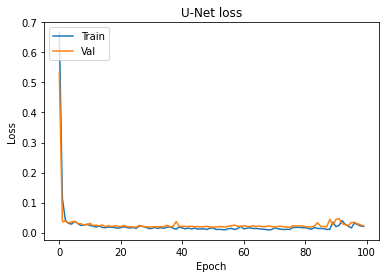

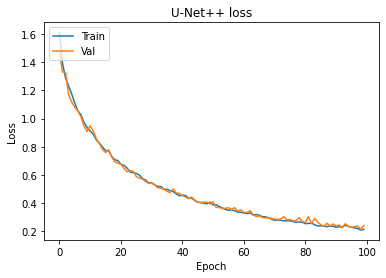

In [17]:
# 훈련 과정 시각화 (손실)
plt.figure(1)
plt.plot(history_unet.history['loss'])
plt.plot(history_unet.history['val_loss'])
plt.title('U-Net loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Val'], loc='upper left')

plt.figure(2)
plt.plot(history_unet_plus.history['loss'])
plt.plot(history_unet_plus.history['val_loss'])
plt.title('U-Net++ loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Val'], loc='upper left')

plt.show()

In [ ]:
# 저장된 U-Net 모델 불러오기

'''
from keras.models import load_model

model_dir = os.getenv('HOME')+'/aiffel/workspace/semantic_segmentation/models/'
model = load_model(model_dir + 'unet.h5')
model_plus = load_model(model_dir + 'unet++.h5')
'''

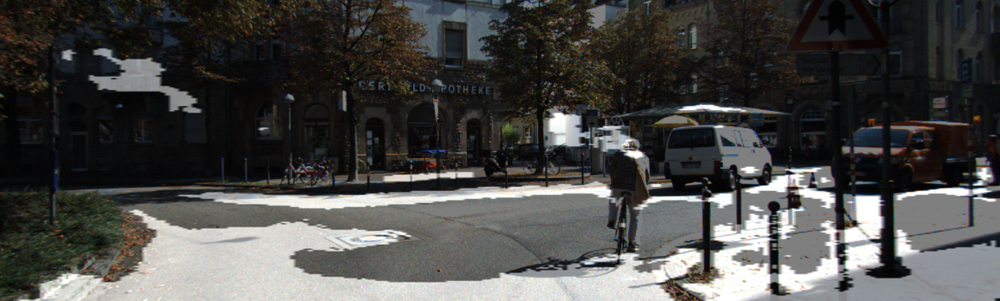

IoU : 0.325464


0.3254639648501541

In [18]:
# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!

i = 3    # 테스트용 파일 파싱을 위한 인덱스처럼 사용

#unet 결과 시각화 + iou 계산
output, prediction, target = get_output(
     model, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

calculate_iou_score(target, prediction)

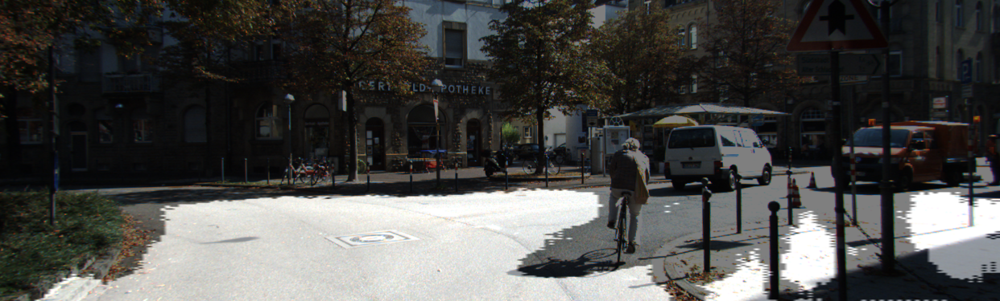

IoU : 0.592573


0.5925728635568069

In [19]:
i = 3    

output, prediction, target = get_output(
     model_unet_plus, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

calculate_iou_score(target, prediction)

In [29]:
from keras.models import load_model

model_dir = os.getenv('HOME')+'/aiffel/workspace/semantic_segmentation/models/'

model = load_model(model_dir + 'unet.h5')
model_unet_plus = load_model(model_dir + 'unet++.h5')

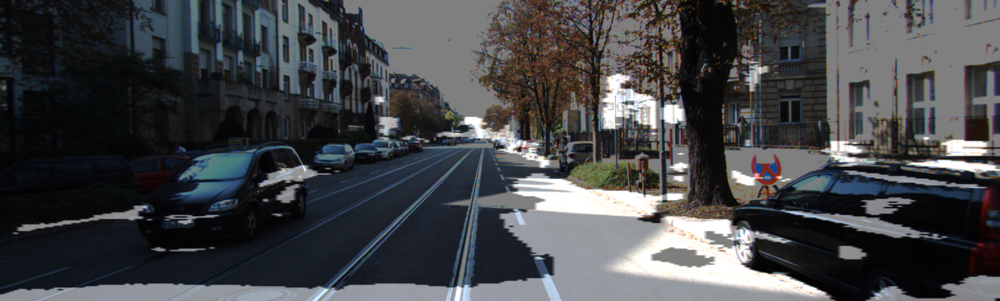

U-Net
IoU : 0.315381


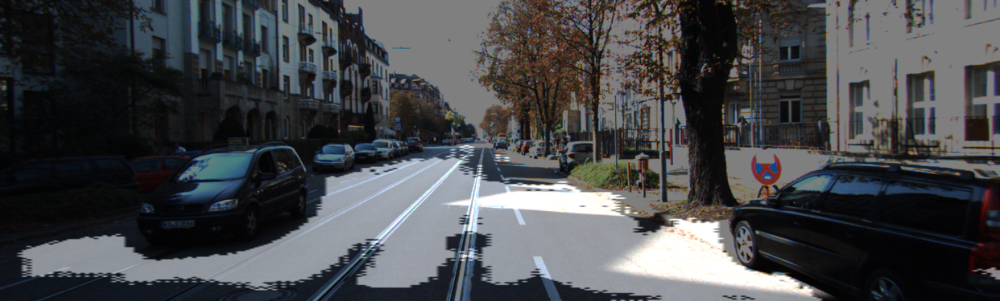

U-Net++
IoU : 0.640740
----------------------------------------------------------------------------------


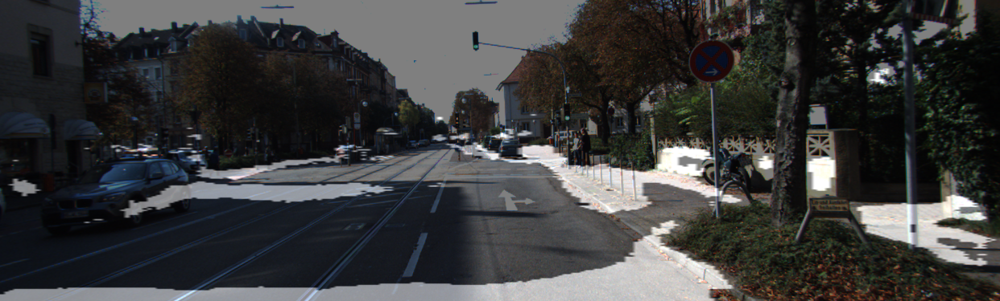

U-Net
IoU : 0.185272


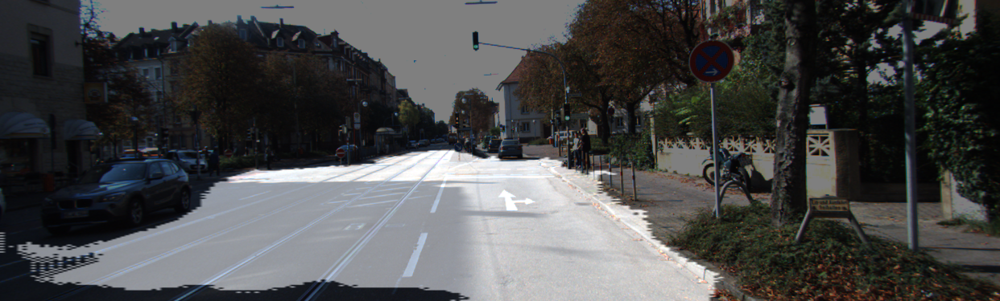

U-Net++
IoU : 0.795803
----------------------------------------------------------------------------------


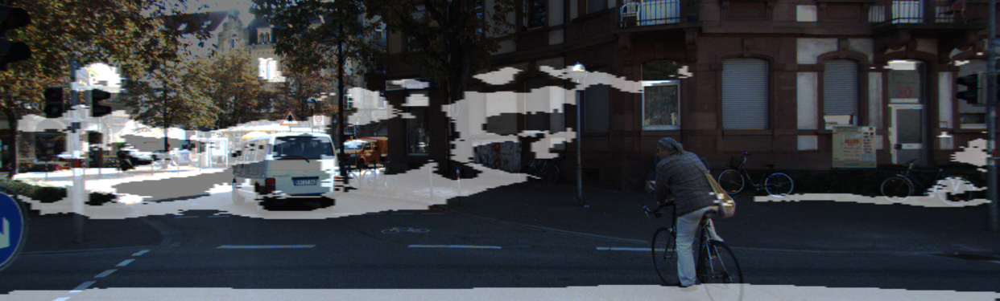

U-Net
IoU : 0.180711


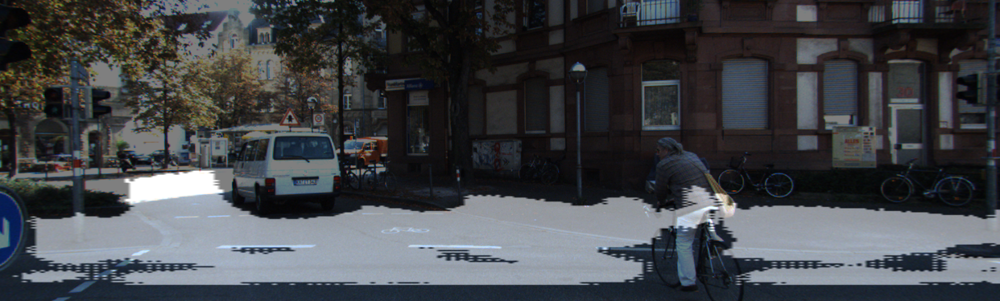

U-Net++
IoU : 0.459171
----------------------------------------------------------------------------------


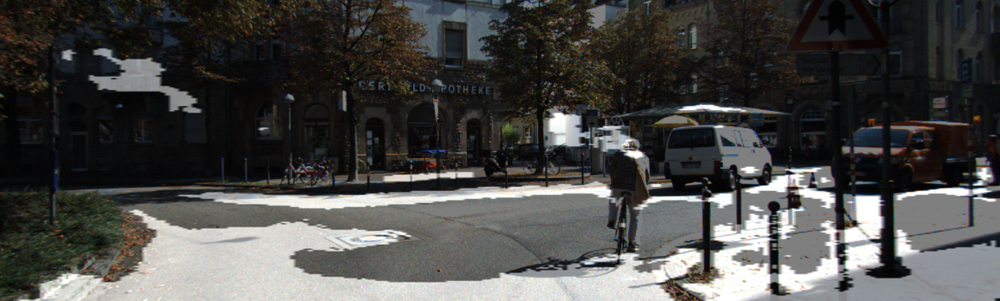

U-Net
IoU : 0.325464


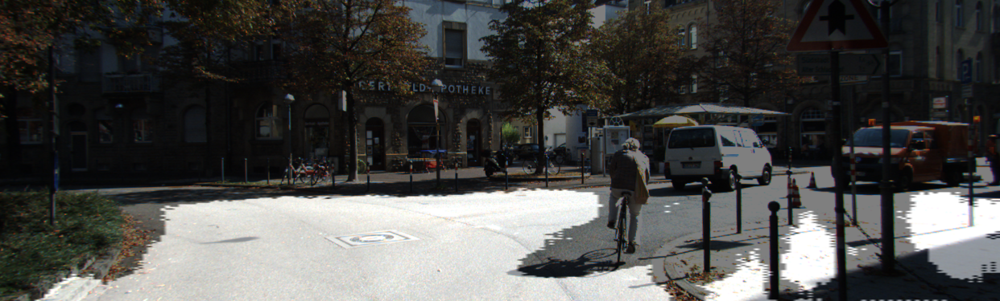

U-Net++
IoU : 0.592573
----------------------------------------------------------------------------------


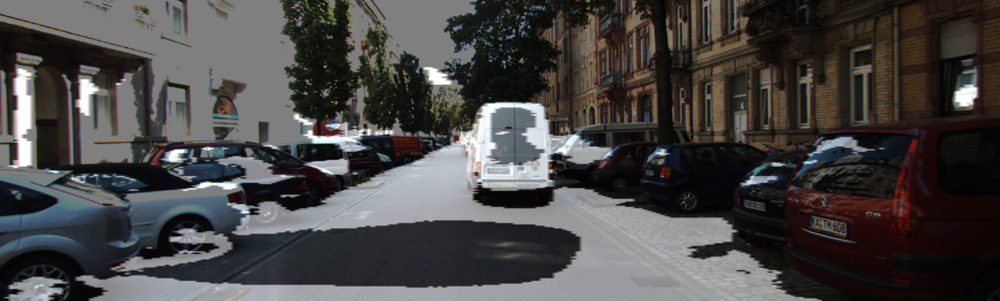

U-Net
IoU : 0.283321


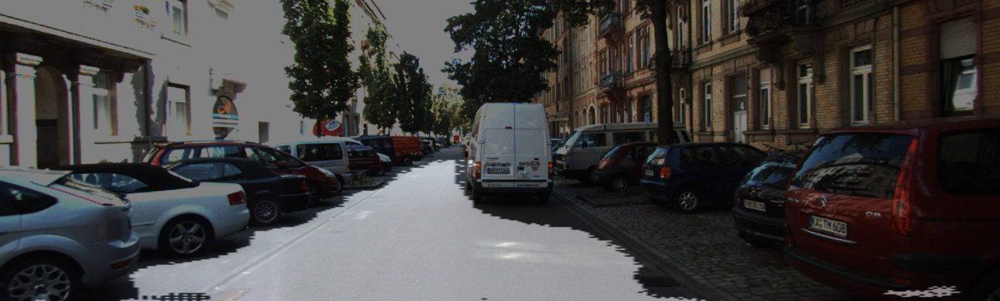

U-Net++
IoU : 0.758492
----------------------------------------------------------------------------------


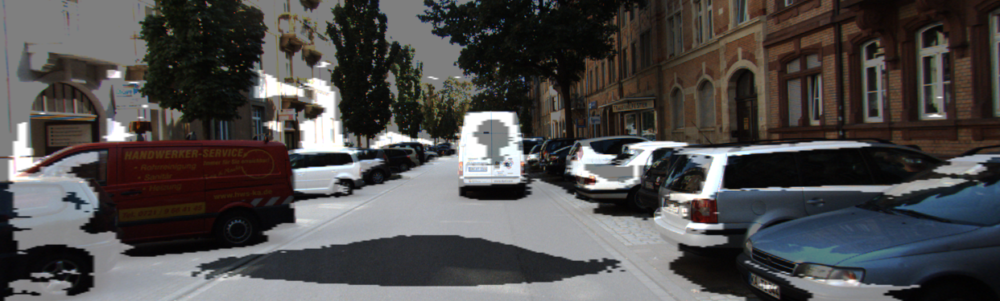

U-Net
IoU : 0.284114


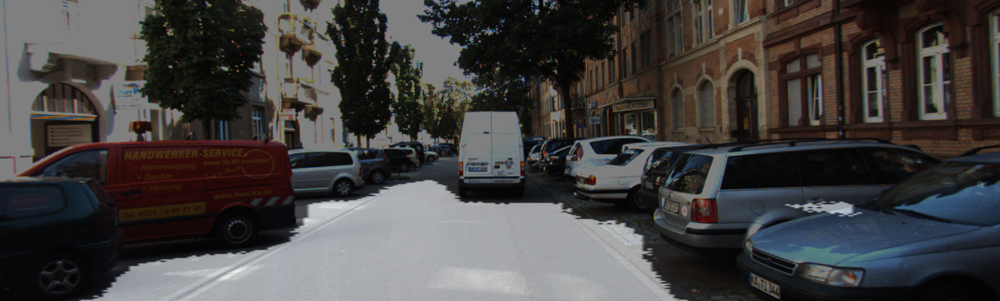

U-Net++
IoU : 0.776716
----------------------------------------------------------------------------------


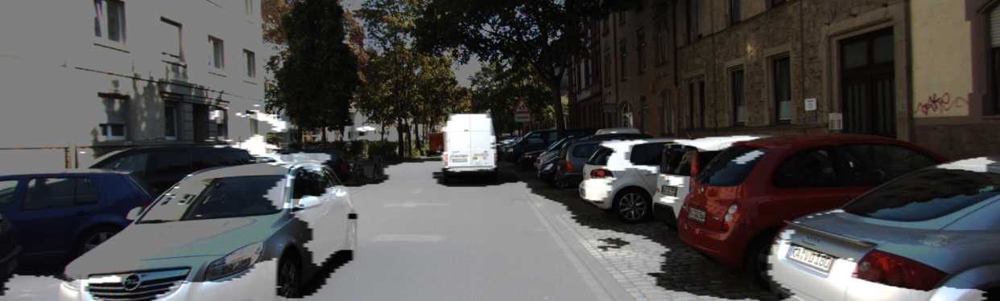

U-Net
IoU : 0.465908


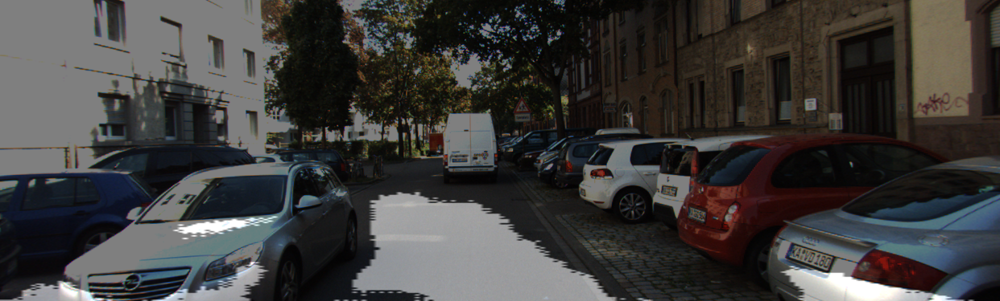

U-Net++
IoU : 0.512439
----------------------------------------------------------------------------------


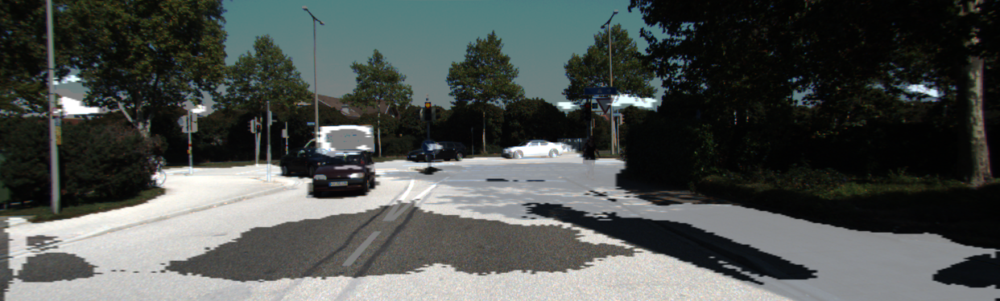

U-Net
IoU : 0.443576


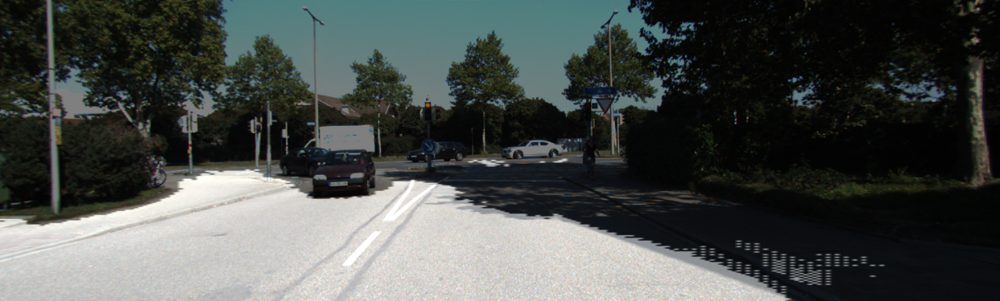

U-Net++
IoU : 0.747273
----------------------------------------------------------------------------------


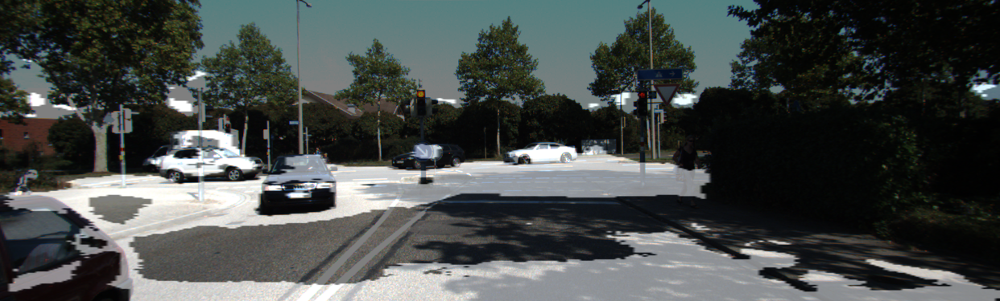

U-Net
IoU : 0.395614


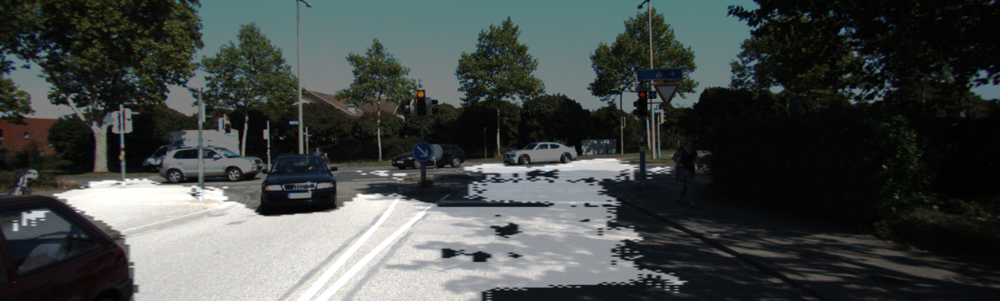

U-Net++
IoU : 0.660284
----------------------------------------------------------------------------------


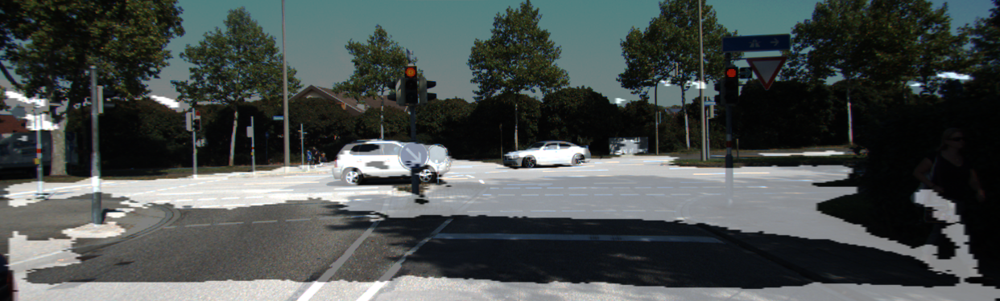

U-Net
IoU : 0.348803


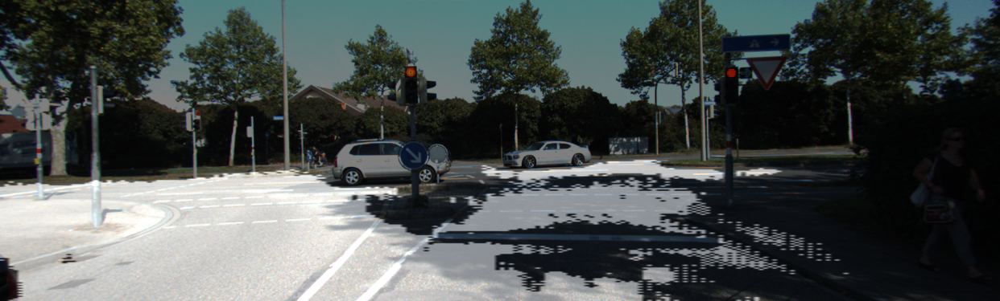

U-Net++
IoU : 0.620899
----------------------------------------------------------------------------------


In [36]:
# 10개의 테스트 데이터 셋에서 확인하기

unet_list = []
plus_list = []

for i in range(10):
    output, prediction, target = get_output(
        model, 
        test_preproc,
        image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
        output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
        label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
    )
    print("U-Net")
    unet_iou = calculate_iou_score(target, prediction)
    unet_list.append(unet_iou)

    output, prediction, target = get_output(
        model_unet_plus, 
        test_preproc,
        image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
        output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
        label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
    )
    print("U-Net++")
    unetplus_iou = calculate_iou_score(target, prediction)
    plus_list.append(unetplus_iou)
    
    print("----------------------------------------------------------------------------------")
    

In [38]:
print('Unet vs Unet++')
print('metric : IoU')

for i in range(10):
      print(f'test_image_{i+1}: unet = {unet_list[i]} vs unet++ = {plus_list[i]}')
      
      if unet_list[i] > plus_list[i]:
            print('unet win')
      
      else:
            print('unet++ win')
      
      print('----------------------------')
    
    
    

Unet vs Unet++
metric : IoU
test_image_1: unet = 0.31538052862265903 vs unet++ = 0.6407398624614655
unet++ win
----------------------------
test_image_2: unet = 0.185271922976841 vs unet++ = 0.7958032490974729
unet++ win
----------------------------
test_image_3: unet = 0.18071077996570278 vs unet++ = 0.4591712174751044
unet++ win
----------------------------
test_image_4: unet = 0.3254639648501541 vs unet++ = 0.5925728635568069
unet++ win
----------------------------
test_image_5: unet = 0.28332070388145153 vs unet++ = 0.75849157528751
unet++ win
----------------------------
test_image_6: unet = 0.284113675150256 vs unet++ = 0.7767157838842427
unet++ win
----------------------------
test_image_7: unet = 0.46590789335019495 vs unet++ = 0.5124386825508059
unet++ win
----------------------------
test_image_8: unet = 0.443575740155217 vs unet++ = 0.7472733838931022
unet++ win
----------------------------
test_image_9: unet = 0.39561443581544087 vs unet++ = 0.6602839756592292
unet++ win
--

# 회고하기

1. 두 모델을 비교한 결과, 테스트 데이터에 대해 segmentation한 결과는 test data 10가지 모두의 경우에서  
   더 좋은 성능을 보였다.
   
2. U-Net++가 더 좋은 성능을 내는 이유에 대해 아키텍쳐 설계 부분애서 이해하기 어려웠다. 
   100에폭 기준으로 unet의 학습 과정에서 loss가 초반에 급격하게 감소하는데의 이유를 파악하는 것이 필요해 보인다.

3. 실제 모델이 추론한 시각화 결과를 보면 unet++가 대체로 도로를 잘 파악하는 것을 알 수 있다. 특히, 도로 위의 차량과 도로를  
   구분한다는 점에서 unet과 차이가 있어 보인다.